# 1 数据集准备和可视化

In [1]:
%cd mmdetection
!mkdir data
%cd data
!rm -rf Drink_284_Detection_coco*
!wget https://zihao-download.obs.cn-east-3.myhuaweicloud.com/yolov8/datasets/Drink_284_Detection_Dataset/Drink_284_Detection_coco.zip
!unzip Drink_284_Detection_coco.zip -d . 

/files/OpenMMlabAI/MMDetection/mmdetection
mkdir: cannot create directory ‘data’: File exists
/files/OpenMMlabAI/MMDetection/mmdetection/data
--2023-06-10 15:56:01--  https://zihao-download.obs.cn-east-3.myhuaweicloud.com/yolov8/datasets/Drink_284_Detection_Dataset/Drink_284_Detection_coco.zip
Connecting to 127.0.0.1:7890... connected.
Proxy request sent, awaiting response... 200 OK
Length: 255180082 (243M) [application/zip]
Saving to: ‘Drink_284_Detection_coco.zip’

Drink_284_Detection 100%[===================>] 243.36M  6.06MB/s    in 44s     

2023-06-10 15:56:45 (5.47 MB/s) - ‘Drink_284_Detection_coco.zip’ saved [255180082/255180082]

Archive:  Drink_284_Detection_coco.zip
   creating: ./Drink_284_Detection_coco/
   creating: ./Drink_284_Detection_coco/images/
  inflating: ./Drink_284_Detection_coco/images/DSC_3698.jpg  
  inflating: ./Drink_284_Detection_coco/images/IMG_20230418_195346.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3673.jpg  
  inflating: ./Drink_284_Det

  inflating: ./Drink_284_Detection_coco/images/IMG_20230418_195322.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3818.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3615.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3601.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3761.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3775.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3748.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3774.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3760.jpg  
  inflating: ./Drink_284_Detection_coco/images/IMG_20230418_200553.jpg  
  inflating: ./Drink_284_Detection_coco/images/IMG_20230418_195725.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3600.jpg  
  inflating: ./Drink_284_Detection_coco/images/IMG_20230418_200157.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3614.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3816.jpg  
  inflating: ./Drink_284_D

  inflating: ./Drink_284_Detection_coco/images/DSC_3650.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3644.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3678.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3693.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3687.jpg  
  inflating: ./Drink_284_Detection_coco/images/IMG_20230418_145420.jpg  
  inflating: ./Drink_284_Detection_coco/images/IMG_20230418_195413.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3683.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3697.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3640.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3654.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3668.jpg  
  inflating: ./Drink_284_Detection_coco/images/IMG_20230418_201802.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3734.jpg  
  inflating: ./Drink_284_Detection_coco/images/DSC_3720.jpg  
  inflating: ./Drink_284_Detection_co

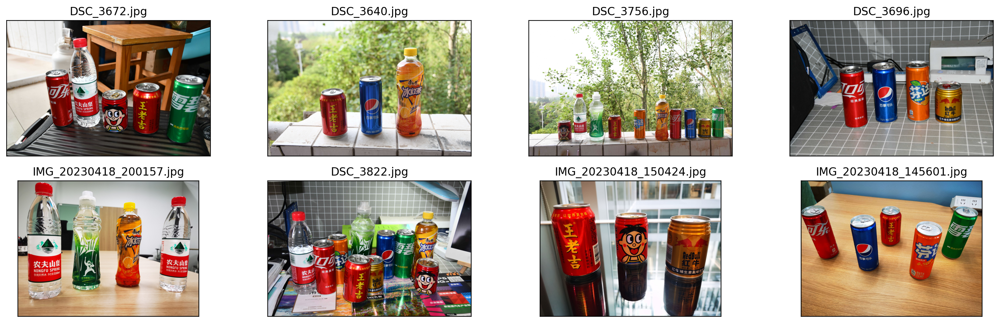

In [2]:
# 数据集可视化
import os
import matplotlib.pyplot as plt
from PIL import Image

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

original_images = []
images = []
texts = []
plt.figure(figsize=(16, 5))

image_paths= [filename for filename in os.listdir('Drink_284_Detection_coco/images')][:8]

for i,filename in enumerate(image_paths):
    name = os.path.splitext(filename)[0]

    image = Image.open('Drink_284_Detection_coco/images/'+filename).convert("RGB")
  
    plt.subplot(2, 4, i+1)
    plt.imshow(image)
    plt.title(f"{filename}")
    plt.xticks([])
    plt.yticks([])

plt.tight_layout()

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


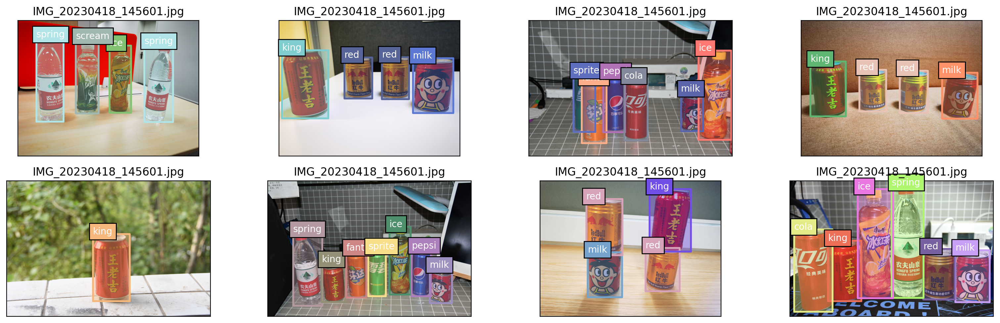

In [3]:
# coco格式的json文件可视化
from pycocotools.coco import COCO
import numpy as np
import os.path as osp
from matplotlib.collections import PatchCollection
from matplotlib.patches import Polygon

def apply_exif_orientation(image):
    _EXIF_ORIENT = 274
    if not hasattr(image, 'getexif'):
        return image

    try:
        exif = image.getexif()
    except Exception:
        exif = None

    if exif is None:
        return image

    orientation = exif.get(_EXIF_ORIENT)

    method = {
        2: Image.FLIP_LEFT_RIGHT,
        3: Image.ROTATE_180,
        4: Image.FLIP_TOP_BOTTOM,
        5: Image.TRANSPOSE,
        6: Image.ROTATE_270,
        7: Image.TRANSVERSE,
        8: Image.ROTATE_90,
    }.get(orientation)
    if method is not None:
        return image.transpose(method)
    return image


def show_bbox_only(coco, anns, show_label_bbox=True, is_filling=True):
    """Show bounding box of annotations Only."""
    if len(anns) == 0:
        return

    ax = plt.gca()
    ax.set_autoscale_on(False)

    image2color = dict()
    for cat in coco.getCatIds():
        image2color[cat] = (np.random.random((1, 3)) * 0.7 + 0.3).tolist()[0]

    polygons = []
    colors = []

    for ann in anns:
        color = image2color[ann['category_id']]
        bbox_x, bbox_y, bbox_w, bbox_h = ann['bbox']
        poly = [[bbox_x, bbox_y], [bbox_x, bbox_y + bbox_h],
                [bbox_x + bbox_w, bbox_y + bbox_h], [bbox_x + bbox_w, bbox_y]]
        polygons.append(Polygon(np.array(poly).reshape((4, 2))))
        colors.append(color)

        if show_label_bbox:
            label_bbox = dict(facecolor=color)
        else:
            label_bbox = None

        ax.text(
            bbox_x,
            bbox_y,
            '%s' % (coco.loadCats(ann['category_id'])[0]['name']),
            color='white',
            bbox=label_bbox)

    if is_filling:
        p = PatchCollection(
            polygons, facecolor=colors, linewidths=0, alpha=0.4)
        ax.add_collection(p)
    p = PatchCollection(
        polygons, facecolor='none', edgecolors=colors, linewidths=2)
    ax.add_collection(p)

    
coco = COCO('Drink_284_Detection_coco/train_coco.json')
image_ids = coco.getImgIds()
np.random.shuffle(image_ids)

plt.figure(figsize=(16, 5))

# 只可视化 8 张图片
for i in range(8):
    image_data = coco.loadImgs(image_ids[i])[0]
    image_path = osp.join('Drink_284_Detection_coco/images/',image_data['file_name'])
    annotation_ids = coco.getAnnIds(
            imgIds=image_data['id'], catIds=[], iscrowd=0)
    annotations = coco.loadAnns(annotation_ids)
    
    ax = plt.subplot(2, 4, i+1)
    image = Image.open(image_path).convert("RGB")
    
    # 这行代码很关键，否则可能图片和标签对不上
    image=apply_exif_orientation(image)
    
    ax.imshow(image)
    
    show_bbox_only(coco, annotations)
    
    plt.title(f"{filename}")
    plt.xticks([])
    plt.yticks([])
        
plt.tight_layout()    

In [4]:
%cd ../projects
!mkdir rtmdet_drink_detection
%cd rtmdet_drink_detection

/files/OpenMMlabAI/MMDetection/mmdetection/projects
/files/OpenMMlabAI/MMDetection/mmdetection/projects/rtmdet_drink_detection


# 2 自定义配置文件

In [12]:
# 当前路径位于 mmdetection/tutorials, 配置将写到 mmdetection/tutorials 路径下

config_drink = """
_base_ = '../../configs/rtmdet/rtmdet_tiny_8xb32-300e_coco.py'

data_root = '../../data/Drink_284_Detection_coco/'

# 非常重要
metainfo = {
    # 类别名，注意 classes 需要是一个 tuple，因此即使是单类，
    # 你应该写成 `cat,` 很多初学者经常会在这犯错
    'classes': ('cola','pepsi','sprite','fanta','spring','ice','scream','milk','red','king'),
    'palette': [
        (220, 20, 60),(20,50,100),(20,90,40),(180,80,30),(220,220,220),(100,50,10),(144,192,112),(138,51,60),(154,89,11),(92,12,11)
    ]
}
num_classes = 10

# 训练 50 epoch
max_epochs = 50
# 训练单卡 bs= 24
train_batch_size_per_gpu = 24
# 可以根据自己的电脑修改
train_num_workers = 4

# 验证集 batch size 为 1
val_batch_size_per_gpu = 1
val_num_workers = 2

# RTMDet 训练过程分成 2 个 stage，第二个 stage 会切换数据增强 pipeline
num_epochs_stage2 = 5

# batch 改变了，学习率也要跟着改变， 0.004 是 8卡x32 的学习率
base_lr = 24 * 0.004 / (32*8)

# 采用 COCO 预训练权重
load_from = 'https://download.openmmlab.com/mmdetection/v3.0/rtmdet/rtmdet_tiny_8xb32-300e_coco/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth'  # noqa

model = dict(
    # 考虑到数据集太小，且训练时间很短，我们把 backbone 完全固定
    # 用户自己的数据集可能需要解冻 backbone
    # backbone=dict(frozen_stages=4),
    # 不要忘记修改 num_classes
    bbox_head=dict(dict(num_classes=num_classes)))

# 数据集不同，dataset 输入参数也不一样
train_dataloader = dict(
    batch_size=train_batch_size_per_gpu,
    num_workers=train_num_workers,
    pin_memory=False,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        ann_file='train_coco.json',
        data_prefix=dict(img='images/')))

val_dataloader = dict(
    batch_size=val_batch_size_per_gpu,
    num_workers=val_num_workers,
    dataset=dict(
        metainfo=metainfo,
        data_root=data_root,
        ann_file='val_coco.json',
        data_prefix=dict(img='images/')))

test_dataloader = val_dataloader

param_scheduler = [
    dict(
        type='LinearLR',
        start_factor=1.0e-5,
        by_epoch=False,
        begin=0,
        end=30),
    dict(
        type='CosineAnnealingLR',
        eta_min=base_lr * 0.05,
        begin=max_epochs // 2,  # max_epoch 也改变了
        end=max_epochs,
        T_max=max_epochs // 2,
        by_epoch=True,
        convert_to_iter_based=True),
]
optim_wrapper = dict(optimizer=dict(lr=base_lr))

# 第二 stage 切换 pipeline 的 epoch 时刻也改变了
_base_.custom_hooks[1].switch_epoch = max_epochs - num_epochs_stage2

val_evaluator = dict(ann_file=data_root + 'val_coco.json')
test_evaluator = val_evaluator

# 一些打印设置修改
default_hooks = dict(
    checkpoint=dict(interval=10, max_keep_ckpts=2, save_best='auto'),  # 同时保存最好性能权重
    logger=dict(type='LoggerHook', interval=5))
train_cfg = dict(max_epochs=max_epochs, val_interval=10)
"""

with open('rtmdet_tiny_1xb24-50e_drink.py', 'w') as f:
    f.write(config_drink)

# 3 训练前可视化验证

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


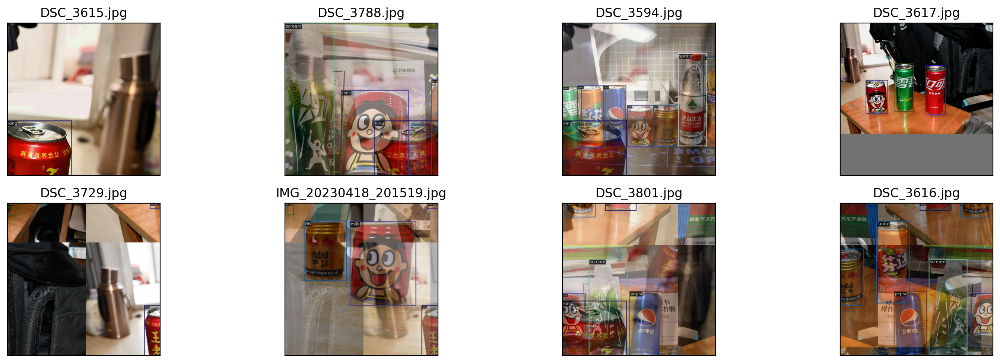

In [15]:
from mmdet.registry import DATASETS, VISUALIZERS
from mmengine.config import Config
from mmengine.registry import init_default_scope

cfg = Config.fromfile('rtmdet_tiny_1xb24-50e_drink.py')

init_default_scope(cfg.get('default_scope', 'mmdet'))

dataset = DATASETS.build(cfg.train_dataloader.dataset)
visualizer = VISUALIZERS.build(cfg.visualizer)
visualizer.dataset_meta = dataset.metainfo

plt.figure(figsize=(16, 5))

# 只可视化前 8 张图片
for i in range(8):
    item=dataset[i]

    img = item['inputs'].permute(1, 2, 0).numpy()
    data_sample = item['data_samples'].numpy()
    gt_instances = data_sample.gt_instances
    img_path = osp.basename(item['data_samples'].img_path)

    gt_bboxes = gt_instances.get('bboxes', None)
    gt_instances.bboxes = gt_bboxes.tensor
    data_sample.gt_instances = gt_instances  

    visualizer.add_datasample(
            osp.basename(img_path),
            img,
            data_sample,
            draw_pred=False,
            show=False)
    drawed_image=visualizer.get_image()

    plt.subplot(2, 4, i+1)
    plt.imshow(drawed_image[..., [2, 1, 0]])
    plt.title(f"{osp.basename(img_path)}")
    plt.xticks([])
    plt.yticks([])

plt.tight_layout()    

# 4 模型训练

In [16]:
!python ../../tools/train.py rtmdet_tiny_1xb24-50e_drink.py

/bin/bash: /home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /bin/bash)
06/10 16:44:22 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.8.16 (default, Mar  2 2023, 03:21:46) [GCC 11.2.0]
    CUDA available: True
    numpy_random_seed: 1664873385
    GPU 0: NVIDIA GeForce RTX 3080 Ti
    CUDA_HOME: /usr/local/cuda-11.1
    NVCC: Cuda compilation tools, release 11.1, V11.1.105
    GCC: gcc (Ubuntu 9.4.0-1ubuntu1~20.04.1) 9.4.0
    PyTorch: 1.10.1+cu113
    PyTorch compiling details: PyTorch built with:
  - GCC 7.3
  - C++ Version: 201402
  - Intel(R) Math Kernel Library Version 2020.0.0 Product Build 20191122 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.2.3 (Git Hash 7336ca9f055cf1bfa13efb658fe15dc9b41f0740)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided b

06/10 16:44:26 - mmengine - INFO - Distributed training is not used, all SyncBatchNorm (SyncBN) layers in the model will be automatically reverted to BatchNormXd layers if they are used.
06/10 16:44:26 - mmengine - INFO - Hooks will be executed in the following order:
before_run:
(VERY_HIGH   ) RuntimeInfoHook                    
(49          ) EMAHook                            
(BELOW_NORMAL) LoggerHook                         
 -------------------- 
after_load_checkpoint:
(49          ) EMAHook                            
 -------------------- 
before_train:
(VERY_HIGH   ) RuntimeInfoHook                    
(49          ) EMAHook                            
(NORMAL      ) IterTimerHook                      
(VERY_LOW    ) CheckpointHook                     
 -------------------- 
before_train_epoch:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
(NORMAL      ) DistSamplerSeedHook                
(NORMAL      ) PipelineSwitchHoo

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
06/10 16:44:27 - mmengine - INFO - load backbone. in model from: https://download.openmmlab.com/mmdetection/v3.0/rtmdet/cspnext_rsb_pretrain/cspnext-tiny_imagenet_600e.pth
Loads checkpoint by http backend from path: https://download.openmmlab.com/mmdetection/v3.0/rtmdet/cspnext_rsb_pretrain/cspnext-tiny_imagenet_600e.pth
Loads checkpoint by http backend from path: https://download.openmmlab.com/mmdetection/v3.0/rtmdet/rtmdet_tiny_8xb32-300e_coco/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth
The model and loaded state dict do not match exactly

size mismatch for bbox_head.rtm_cls.0.weight: copying a param with shape torch.Size([80, 96, 1, 1]) from checkpoint, the shape in current model is torch.Size([10, 96, 1, 1]).
size mismatch for bbox_head.rtm_cls.0.bias: copying a param with shape torch.Size([80]) from checkpoint, the shape in current model is torch.Size([10]).
size mismatch for bbox_head.

06/10 16:46:56 - mmengine - INFO - Epoch(train) [10][ 5/10]  lr: 3.7500e-04  eta: 0:10:33  time: 1.5453  data_time: 1.3001  memory: 7583  loss: 1.0780  loss_cls: 0.8385  loss_bbox: 0.2394
06/10 16:47:00 - mmengine - INFO - Exp name: rtmdet_tiny_1xb24-50e_drink_20230610_164422
06/10 16:47:00 - mmengine - INFO - Epoch(train) [10][10/10]  lr: 3.7500e-04  eta: 0:10:11  time: 1.5404  data_time: 1.2965  memory: 7592  loss: 1.0029  loss_cls: 0.7737  loss_bbox: 0.2292
06/10 16:47:00 - mmengine - INFO - Saving checkpoint at 10 epochs
06/10 16:47:02 - mmengine - INFO - Epoch(val) [10][ 5/56]    eta: 0:00:04  time: 0.0847  data_time: 0.0606  memory: 133  
06/10 16:47:02 - mmengine - INFO - Epoch(val) [10][10/56]    eta: 0:00:03  time: 0.0659  data_time: 0.0462  memory: 133  
06/10 16:47:02 - mmengine - INFO - Epoch(val) [10][15/56]    eta: 0:00:02  time: 0.0622  data_time: 0.0438  memory: 133  
06/10 16:47:02 - mmengine - INFO - Epoch(val) [10][20/56]    eta: 0:00:02  time: 0.0591  data_time: 0.0

06/10 16:49:28 - mmengine - INFO - Epoch(train) [20][ 5/10]  lr: 3.7500e-04  eta: 0:07:42  time: 1.4430  data_time: 1.2077  memory: 7583  loss: 0.4693  loss_cls: 0.2905  loss_bbox: 0.1788
06/10 16:49:33 - mmengine - INFO - Exp name: rtmdet_tiny_1xb24-50e_drink_20230610_164422
06/10 16:49:33 - mmengine - INFO - Epoch(train) [20][10/10]  lr: 3.7500e-04  eta: 0:07:30  time: 1.4574  data_time: 1.2223  memory: 7584  loss: 0.4563  loss_cls: 0.2794  loss_bbox: 0.1769
06/10 16:49:33 - mmengine - INFO - Saving checkpoint at 20 epochs
06/10 16:49:34 - mmengine - INFO - Epoch(val) [20][ 5/56]    eta: 0:00:03  time: 0.0546  data_time: 0.0378  memory: 133  
06/10 16:49:34 - mmengine - INFO - Epoch(val) [20][10/56]    eta: 0:00:02  time: 0.0543  data_time: 0.0375  memory: 133  
06/10 16:49:35 - mmengine - INFO - Epoch(val) [20][15/56]    eta: 0:00:02  time: 0.0553  data_time: 0.0385  memory: 133  
06/10 16:49:35 - mmengine - INFO - Epoch(val) [20][20/56]    eta: 0:00:02  time: 0.0530  data_time: 0.0

06/10 16:51:55 - mmengine - INFO - Exp name: rtmdet_tiny_1xb24-50e_drink_20230610_164422
06/10 16:51:55 - mmengine - INFO - Epoch(train) [29][10/10]  lr: 3.5403e-04  eta: 0:05:17  time: 1.5125  data_time: 1.2774  memory: 7586  loss: 0.3713  loss_cls: 0.2116  loss_bbox: 0.1597
06/10 16:52:06 - mmengine - INFO - Epoch(train) [30][ 5/10]  lr: 3.4846e-04  eta: 0:05:11  time: 1.5147  data_time: 1.2799  memory: 7587  loss: 0.3691  loss_cls: 0.2098  loss_bbox: 0.1593
06/10 16:52:11 - mmengine - INFO - Exp name: rtmdet_tiny_1xb24-50e_drink_20230610_164422
06/10 16:52:11 - mmengine - INFO - Epoch(train) [30][10/10]  lr: 3.4229e-04  eta: 0:05:02  time: 1.5329  data_time: 1.2977  memory: 7583  loss: 0.3704  loss_cls: 0.2092  loss_bbox: 0.1612
06/10 16:52:11 - mmengine - INFO - Saving checkpoint at 30 epochs
06/10 16:52:12 - mmengine - INFO - Epoch(val) [30][ 5/56]    eta: 0:00:03  time: 0.0543  data_time: 0.0379  memory: 133  
06/10 16:52:12 - mmengine - INFO - Epoch(val) [30][10/56]    eta: 0:00

06/10 16:54:26 - mmengine - INFO - Epoch(train) [39][ 5/10]  lr: 1.7677e-04  eta: 0:02:54  time: 1.4867  data_time: 1.2530  memory: 7583  loss: 0.3323  loss_cls: 0.1797  loss_bbox: 0.1526
06/10 16:54:31 - mmengine - INFO - Exp name: rtmdet_tiny_1xb24-50e_drink_20230610_164422
06/10 16:54:31 - mmengine - INFO - Epoch(train) [39][10/10]  lr: 1.6570e-04  eta: 0:02:46  time: 1.4896  data_time: 1.2560  memory: 7586  loss: 0.3295  loss_cls: 0.1780  loss_bbox: 0.1515
06/10 16:54:42 - mmengine - INFO - Epoch(train) [40][ 5/10]  lr: 1.5475e-04  eta: 0:02:39  time: 1.4907  data_time: 1.2569  memory: 7586  loss: 0.3269  loss_cls: 0.1764  loss_bbox: 0.1505
06/10 16:54:46 - mmengine - INFO - Exp name: rtmdet_tiny_1xb24-50e_drink_20230610_164422
06/10 16:54:46 - mmengine - INFO - Epoch(train) [40][10/10]  lr: 1.4396e-04  eta: 0:02:31  time: 1.5000  data_time: 1.2663  memory: 7583  loss: 0.3247  loss_cls: 0.1746  loss_bbox: 0.1501
06/10 16:54:46 - mmengine - INFO - Saving checkpoint at 40 epochs
06/1

06/10 16:56:31 - mmengine - INFO - Exp name: rtmdet_tiny_1xb24-50e_drink_20230610_164422
06/10 16:56:31 - mmengine - INFO - Epoch(train) [48][10/10]  lr: 2.4916e-05  eta: 0:00:29  time: 1.0873  data_time: 0.8626  memory: 7583  loss: 0.2523  loss_cls: 0.1370  loss_bbox: 0.1153
06/10 16:56:36 - mmengine - INFO - Epoch(train) [49][ 5/10]  lr: 2.2338e-05  eta: 0:00:21  time: 0.9837  data_time: 0.7605  memory: 7583  loss: 0.2378  loss_cls: 0.1281  loss_bbox: 0.1097
06/10 16:56:39 - mmengine - INFO - Exp name: rtmdet_tiny_1xb24-50e_drink_20230610_164422
06/10 16:56:39 - mmengine - INFO - Epoch(train) [49][10/10]  lr: 2.0449e-05  eta: 0:00:14  time: 0.9469  data_time: 0.7251  memory: 7583  loss: 0.2304  loss_cls: 0.1241  loss_bbox: 0.1063
06/10 16:56:44 - mmengine - INFO - Epoch(train) [50][ 5/10]  lr: 1.9256e-05  eta: 0:00:07  time: 0.8394  data_time: 0.6195  memory: 7583  loss: 0.2189  loss_cls: 0.1173  loss_bbox: 0.1015
06/10 16:56:46 - mmengine - INFO - Exp name: rtmdet_tiny_1xb24-50e_dri

可以发现最佳性能为第 50 epoch 时候，性能为 96.4 mAP

```text
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.964
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.996
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.996
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.964
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.944
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.973
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.973
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.973
```

# 5 模型测试和推理

In [17]:
!python ../../tools/test.py rtmdet_tiny_1xb24-50e_drink.py work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth --show-dir results

/bin/bash: /home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /bin/bash)
06/10 17:14:27 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.8.16 (default, Mar  2 2023, 03:21:46) [GCC 11.2.0]
    CUDA available: True
    numpy_random_seed: 1680474695
    GPU 0: NVIDIA GeForce RTX 3080 Ti
    CUDA_HOME: /usr/local/cuda-11.1
    NVCC: Cuda compilation tools, release 11.1, V11.1.105
    GCC: gcc (Ubuntu 9.4.0-1ubuntu1~20.04.1) 9.4.0
    PyTorch: 1.10.1+cu113
    PyTorch compiling details: PyTorch built with:
  - GCC 7.3
  - C++ Version: 201402
  - Intel(R) Math Kernel Library Version 2020.0.0 Product Build 20191122 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.2.3 (Git Hash 7336ca9f055cf1bfa13efb658fe15dc9b41f0740)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided b

06/10 17:14:30 - mmengine - INFO - Distributed training is not used, all SyncBatchNorm (SyncBN) layers in the model will be automatically reverted to BatchNormXd layers if they are used.
06/10 17:14:30 - mmengine - INFO - Hooks will be executed in the following order:
before_run:
(VERY_HIGH   ) RuntimeInfoHook                    
(49          ) EMAHook                            
(BELOW_NORMAL) LoggerHook                         
 -------------------- 
after_load_checkpoint:
(49          ) EMAHook                            
 -------------------- 
before_train:
(VERY_HIGH   ) RuntimeInfoHook                    
(49          ) EMAHook                            
(NORMAL      ) IterTimerHook                      
(VERY_LOW    ) CheckpointHook                     
 -------------------- 
before_train_epoch:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
(NORMAL      ) DistSamplerSeedHook                
(NORMAL      ) PipelineSwitchHoo

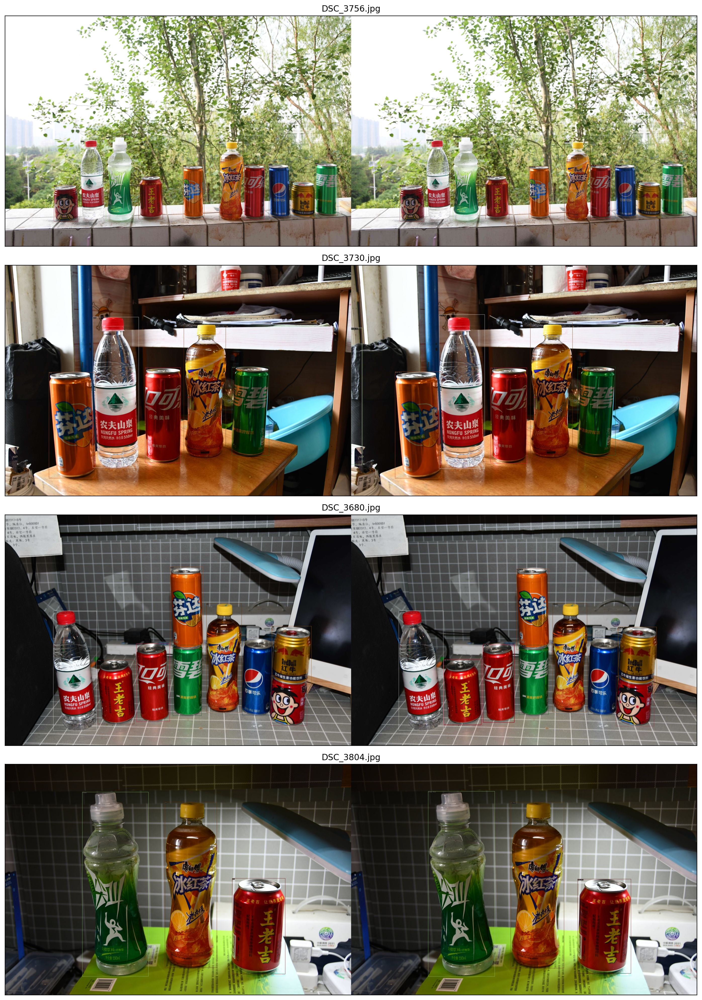

In [18]:
# 数据集可视化

import os
import matplotlib.pyplot as plt
from PIL import Image

%matplotlib inline

plt.figure(figsize=(20, 20))

# 你如果重新跑，这个时间戳是不一样的，需要自己修改
root_path='work_dirs/rtmdet_tiny_1xb24-50e_drink/20230610_171426/results/'
image_paths= [filename for filename in os.listdir(root_path)][:4]

for i,filename in enumerate(image_paths):
    name = os.path.splitext(filename)[0]

    image = Image.open(root_path+filename).convert("RGB")
  
    plt.subplot(4, 1, i+1)
    plt.imshow(image)
    plt.title(f"{filename}")
    plt.xticks([])
    plt.yticks([])

plt.tight_layout()

/bin/bash: /home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /bin/bash)
Loads checkpoint by local backend from path: work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth
06/10 17:29:27 - mmengine - WARNING - Failed to search registry with scope "mmdet" in the "function" registry tree. As a workaround, the current "function" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmdet" is a correct scope, or whether the registry is initialized.
06/10 17:29:27 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.
/home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/torch/functional.p;2;209;42;102m━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   
y:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required 
to pass the indexing argument. (Trigger

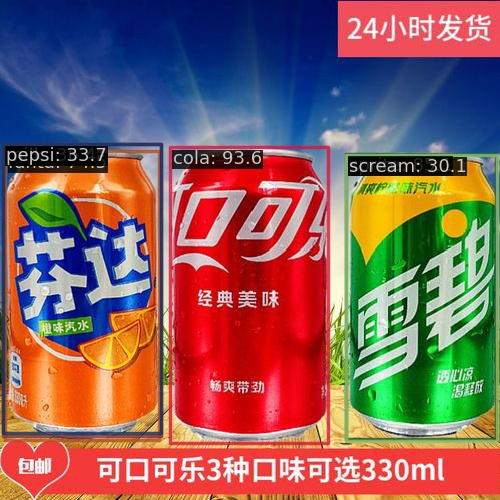

In [21]:
# 检测单张图片
!python ../../demo/image_demo.py ../../demo/drink.jpeg rtmdet_tiny_1xb24-50e_drink.py --weights work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth
Image.open('outputs/vis/drink.jpeg')

/bin/bash: /home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /bin/bash)
Loads checkpoint by local backend from path: work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth
06/10 17:30:07 - mmengine - WARNING - Failed to search registry with scope "mmdet" in the "function" registry tree. As a workaround, the current "function" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmdet" is a correct scope, or whether the registry is initialized.
06/10 17:30:07 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.
/home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/torch/functional.p━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   
y:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required 
to pass the indexing argument. (Triggered internally 

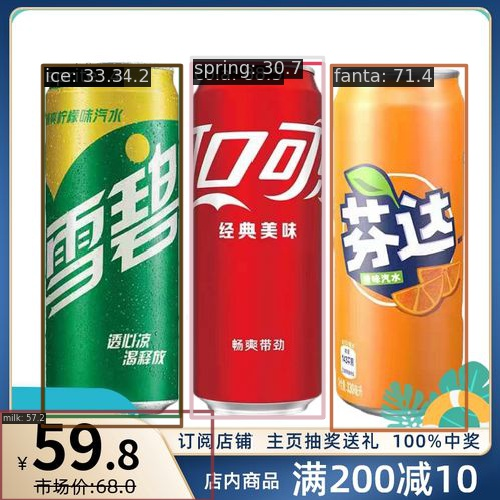

In [23]:
!python ../../demo/image_demo.py ../../demo/drink3.jpeg rtmdet_tiny_1xb24-50e_drink.py --weights work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth
Image.open('outputs/vis/drink3.jpeg')

# 6 可视化分析

In [24]:
# 进入mmyolo文件夹
%cd ../../../mmyolo
!pwd

/files/OpenMMlabAI/MMDetection/mmyolo
/bin/bash: /home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /bin/bash)
/files/OpenMMlabAI/MMDetection/mmyolo


In [25]:
import cv2

img = cv2.imread('../mmdetection/data/Drink_284_Detection_coco/images/DSC_3641.jpg')
h,w=img.shape[:2]
resized_img = cv2.resize(img, (640, 640))
cv2.imwrite('resized_image.jpg', resized_img)

True

**1. 可视化 backbone 输出的 3 个通道**

/bin/bash: /home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /bin/bash)
Loads checkpoint by local backend from path: ../mmdetection/projects/rtmdet_drink_detection/work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth
06/10 17:38:03 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.
[                                                  ] 0/1, elapsed: 0s, ETA:/home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/files/OpenMMlabAI/MMDetection/mmdetection/mmdet/visualization/palette.py:90: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future

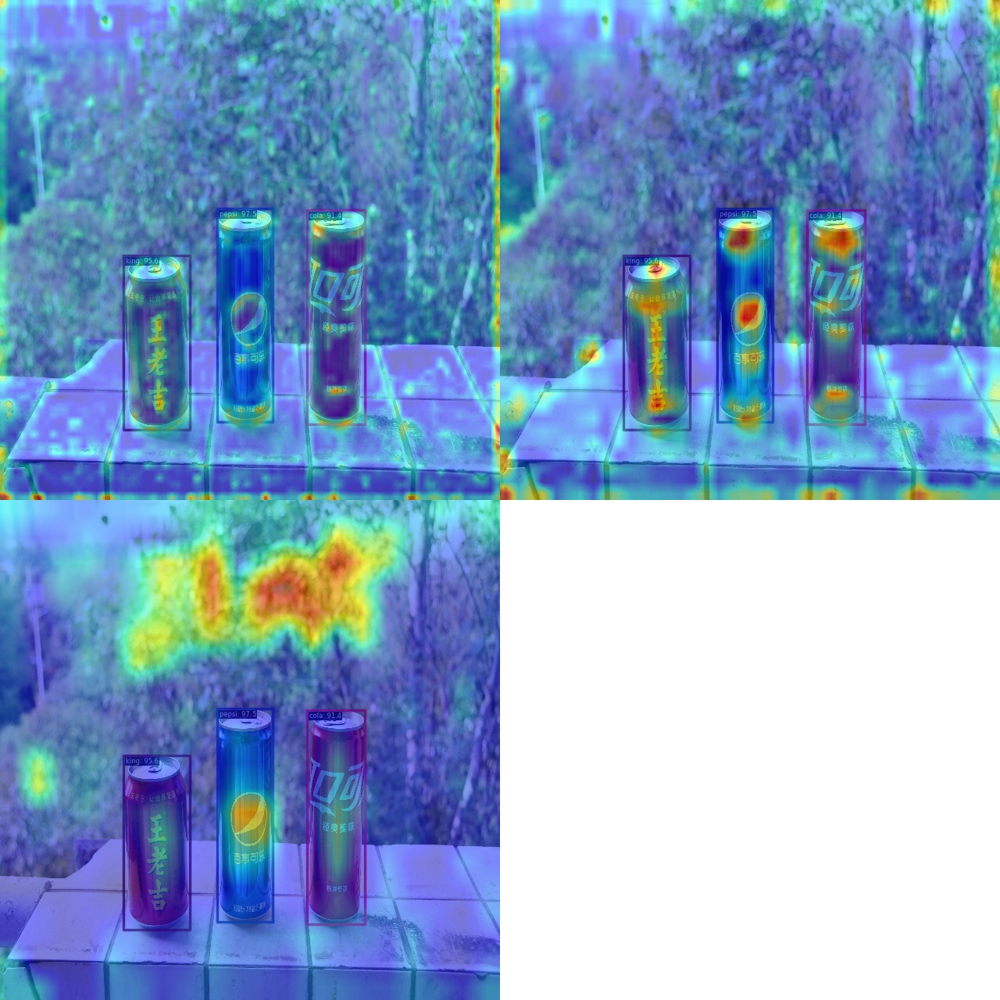

In [26]:
!python demo/featmap_vis_demo.py \
      resized_image.jpg \
      ../mmdetection/projects/rtmdet_drink_detection/rtmdet_tiny_1xb24-50e_drink.py \
      ../mmdetection/projects/rtmdet_drink_detection/work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth  \
      --target-layers backbone  \
      --channel-reduction squeeze_mean
Image.open('output/resized_image.jpg')  

**2. 可视化 neck 输出的 3 个通道**

/bin/bash: /home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /bin/bash)
Loads checkpoint by local backend from path: ../mmdetection/projects/rtmdet_drink_detection/work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth
06/10 17:39:19 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.
[                                                  ] 0/1, elapsed: 0s, ETA:/home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/files/OpenMMlabAI/MMDetection/mmdetection/mmdet/visualization/palette.py:90: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future

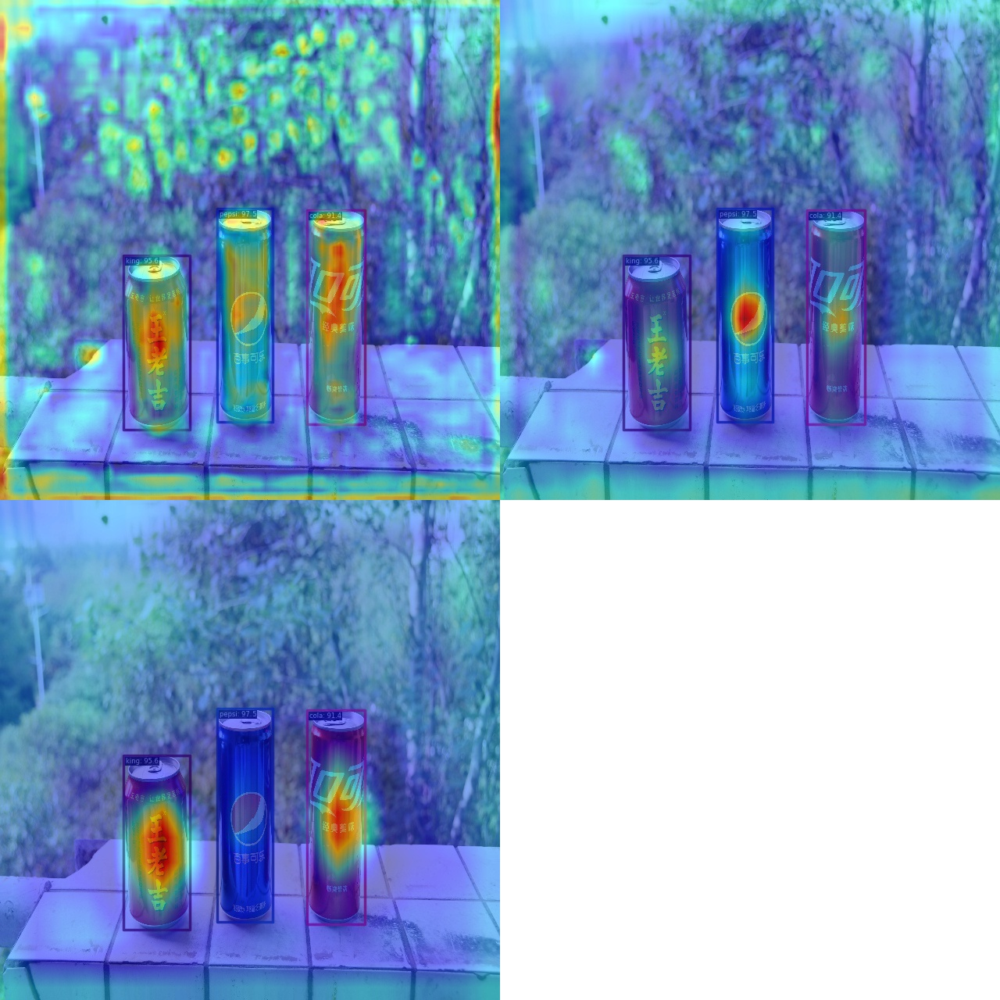

In [27]:
!python demo/featmap_vis_demo.py \
      resized_image.jpg \
      ../mmdetection/projects/rtmdet_drink_detection/rtmdet_tiny_1xb24-50e_drink.py \
      ../mmdetection/projects/rtmdet_drink_detection/work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth  \
      --target-layers neck  \
      --channel-reduction squeeze_mean
Image.open('output/resized_image.jpg') 

# 7 Grad-Based CAM 可视化

**(a) 查看 neck 输出的最小输出特征图的 Grad CAM**

/bin/bash: /home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /bin/bash)
The algorithm currently used is rtmdet
Loads checkpoint by local backend from path: ../mmdetection/projects/rtmdet_drink_detection/work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth
[                                                  ] 0/1, elapsed: 0s, ETA:/home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/torch/nn/functional.py:3631: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corne

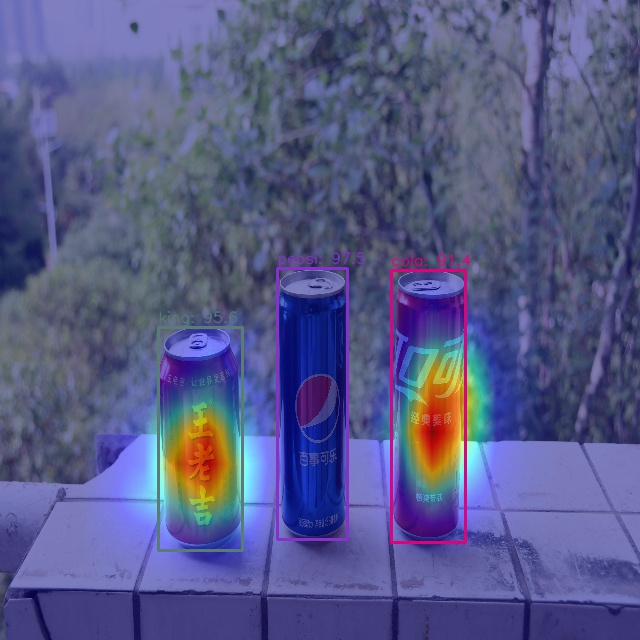

In [28]:
!python demo/boxam_vis_demo.py \
      resized_image.jpg \
      ../mmdetection/projects/rtmdet_drink_detection/rtmdet_tiny_1xb24-50e_drink.py \
      ../mmdetection/projects/rtmdet_drink_detection/work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth  \
      --target-layer neck.out_convs[2]
Image.open('output/resized_image.jpg')       

**(b) 查看 neck 输出的最大输出特征图的 Grad CAM**

/bin/bash: /home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /bin/bash)
The algorithm currently used is rtmdet
Loads checkpoint by local backend from path: ../mmdetection/projects/rtmdet_drink_detection/work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth
[                                                  ] 0/1, elapsed: 0s, ETA:/home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/worker20/.conda/envs/MMPose/lib/python3.8/site-packages/torch/nn/functional.py:3631: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corne

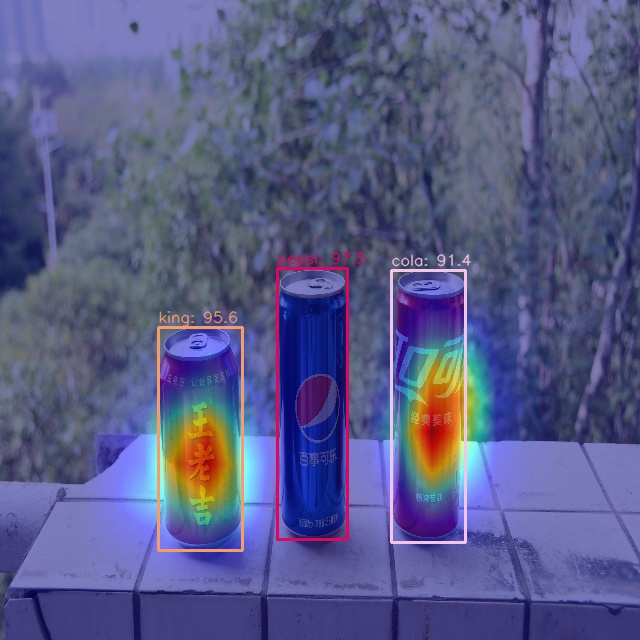

In [29]:
!python demo/boxam_vis_demo.py \
      resized_image.jpg \
      ../mmdetection/projects/rtmdet_drink_detection/rtmdet_tiny_1xb24-50e_drink.py \
      ../mmdetection/projects/rtmdet_drink_detection/work_dirs/rtmdet_tiny_1xb24-50e_drink/best_coco/bbox_mAP_epoch_40.pth  \
      --target-layer neck.out_convs[2]
Image.open('output/resized_image.jpg')     